<a href="https://colab.research.google.com/github/dotimothy/astronomy/blob/main/analysis/ImageStacking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ImageStacking 📚

This notebook aims to explore the purpose of Image Stacking and observe how capturing multiple short exposures is advantegeous than one single exposure for Astrophotography. 

**Author:** [Timothy Do](https://timothydo.me)

## References
[1] PhotographingSpace.com. (2023, December 22). Homework: Download and Stack my Data! [Online]. Available: https://www.photographingspace.com/homework-download-stack-data/ <br>
[2] Ethan Rublee, Vincent Rabaud, Kurt Konolige, and Gary Bradski. ORB: an efficient alternative to SIFT or SURF. In 2011 IEEE International Conference on Computer Vision (ICCV), 1  pages 2564–2571. IEEE, 2011. <br>
[3] AstroBackyard.com. (2024). Deep Sky Stacker Tutorial Practice Files. [Online]. Available: https://astrobackyard.com/dss-practice-files/

## Dependencies

In [1]:
IN_COLAB = True
try: 
    import google.colab
except: 
    IN_COLAB = False
print(f'In CoLab: {IN_COLAB}')

In CoLab: False


In [2]:
if(IN_COLAB):
    !curl https://raw.githubusercontent.com/dotimothy/astronomy/main/requirements.txt -o ./requirements.txt
    !pip install -r requirements.txt
else:
    !pip install -r ../requirements.txt


[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
# Dependencies
import os
import gc
import gdown
import numpy as np
import rawpy
import cv2 as cv
import matplotlib.pyplot as plt 
from tqdm import tqdm

In [37]:
# Global Helper Functions
# Crudely Normalize an Image (float) from 0-1
def normalize(img):
    return (img - img.min())/(img.max()-img.min())

# Contrast Stretches an Image (float)
def contrast_stretch(img,min=0,max=1):
    return np.clip(normalize(img) * (max-min) + min,a_min=0,a_max=1)

# Convert a uint8/uint16 image to a float image
def int_to_float(img):
    return normalize(img.astype(np.float))

# Convert a float image to a uint8 image
def float_to_int(img):
    return ((2**8-1)*normalize(img)).astype(np.uint8)

# Convert a float image to a uint16 image
def float_to_int16(img):
    return ((2**16-1)*normalize(img)).astype(np.uint16)

# Converts CR2 to Numpy Array
def cr2_to_numpy(cr2Path,uint=False,gamma=(1,1),half_size=True,use_camera_wb=False,no_auto_bright=False):
    with rawpy.imread(cr2Path) as raw:
        if(uint):
            out = raw.postprocess() # uint8
        else:
            out = raw.postprocess(gamma=gamma,use_camera_wb=use_camera_wb,no_auto_bright=no_auto_bright,half_size=half_size,output_bps=16,demosaic_algorithm=rawpy.DemosaicAlgorithm.VNG,output_color=rawpy.ColorSpace.sRGB)
            out = out.astype(np.float32)/ 2**16
        if(out.shape[2] > out.shape[1]): # Vertical, must rotate
            out = np.rot90(out,k=3)
    return out

def cr2Dir_to_tensor(stackPath,gamma=(1,1),use_camera_wb=False,half_size=True,no_auto_bright=False,exclude=[]):
    stackFiles = sorted([file for file in os.listdir(stackPath) if (file not in exclude) and (file.endswith('.CR2') or file.endswith('.CR3'))])
    print(f'Stack Files: {stackFiles}')
    print('Stacking Raw Images into a Tensor')
    stackedNumpy = np.stack([cr2_to_numpy(f'{stackPath}/{stackFile}',gamma=gamma,use_camera_wb=use_camera_wb,half_size=half_size,no_auto_bright=no_auto_bright) for stackFile in tqdm(stackFiles)])
    print(f'Stacked Numpy Shape: {stackedNumpy.shape}')
    print(f'Stacked Numpy Data Type: {stackedNumpy.dtype}')
    gc.collect()
    return stackedNumpy 

## Downloading the Data
For exploring the process of Image Stacking, we will be downloading a "Homework" example from Cory Schmitz's blog in the [PhotographSpace](https://www.photographingspace.com/homework-download-stack-data/) site! He takes a really nice shot of the milky way that we can work with. [1]

Here are some logisitcs of the stack, taken on a static tripod: 

- **Camera:** Canon 5D Mark III 
- **ISO:** 6400
- **Exposure Length:** 15 seconds
- **White Balance:** 4250K

In [5]:
# Creating Directory to Store the Data
dataDir1 = '../data/imagestacking/photographspace'
os.makedirs(dataDir1,exist_ok=True)

In [6]:
# Downloading the Single Raw Image & Full Stack
site = "https://www.photographingspace.com/downloads/"
singleRawFile = "CSM30803.CR2"
stackFile = "11x_ISO6400_f2.8_15s_5DMkIII_raw.zip"
for file in [singleRawFile,stackFile]: 
    filePath = f'{dataDir1}/{file}'
    if(not(os.path.exists(filePath))):
        fileLink = f'{site}/{file}'
        os.system(f'curl {fileLink} -o {filePath}')
    if(file.endswith('.zip')):
        zipDir = filePath.split('.zip')[0]
        if(not(os.path.exists(zipDir))):
            os.system(f'unzip {filePath} -d {zipDir}')

## Visualizing the Data

Single Raw Numpy Shape: (1935, 2898, 3)
Single Raw Numpy Data Type: float64


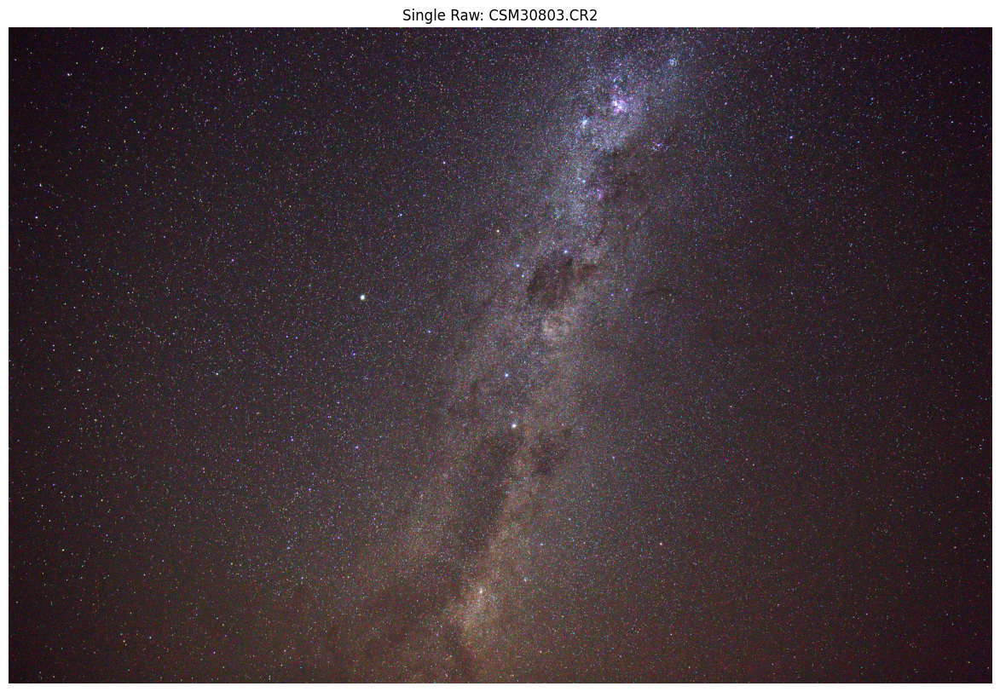

In [7]:
# Extracting Single Raw Image & Viewing
singleRawPath = f'{dataDir1}/{singleRawFile}'
singleRaw = cr2_to_numpy(singleRawPath,use_camera_wb=True)
print(f'Single Raw Numpy Shape: {singleRaw.shape}')
print(f'Single Raw Numpy Data Type: {singleRaw.dtype}')
cv.imwrite(f"{dataDir1}/{singleRawFile.strip('.CR2')}.tiff",float_to_int16(singleRaw)[...,::-1])

# Plotting
plt.figure(figsize=(15,10))
plt.title(f'Single Raw: {singleRawFile}')
plt.imshow(contrast_stretch(singleRaw))
plt.axis('off')
plt.show()

In [8]:
# Read the Stacks into Memory
stackPath = f'{dataDir1}/11x_ISO6400_f2.8_15s_5DMkIII_raw/raw'
stackFiles = sorted([file for file in os.listdir(stackPath) if file.endswith('.CR2')])
stackedNumpy = cr2Dir_to_tensor(stackPath,use_camera_wb=True)

Stack Files: ['CSM30799.CR2', 'CSM30800.CR2', 'CSM30801.CR2', 'CSM30802.CR2', 'CSM30803.CR2', 'CSM30804.CR2', 'CSM30805.CR2', 'CSM30806.CR2', 'CSM30807.CR2', 'CSM30808.CR2', 'CSM30809.CR2']
Stacking Raw Images into a Tensor


100%|████████████████████████████████████████████████████████████| 11/11 [00:06<00:00,  1.71it/s]


Stacked Numpy Shape: (11, 1935, 2898, 3)
Stacked Numpy Data Type: float64


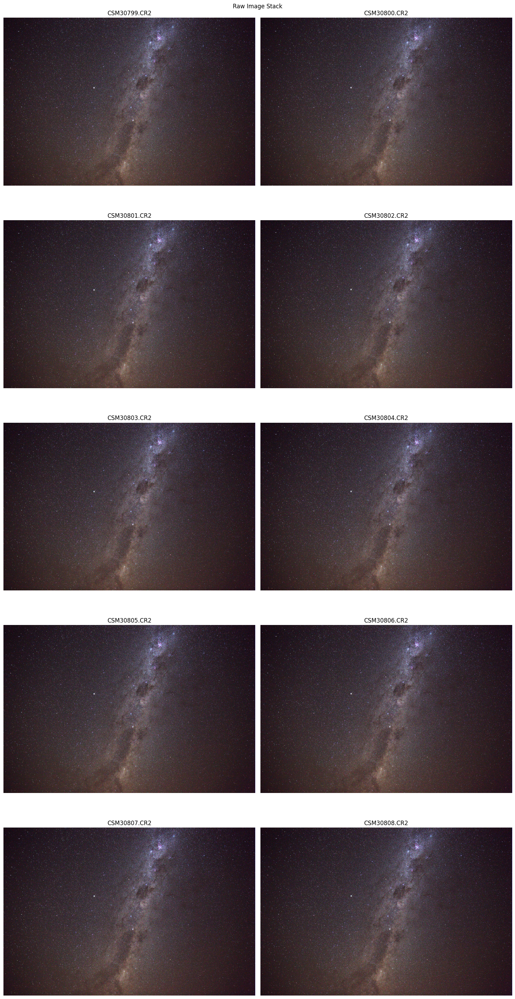

In [9]:
# Viewing the Stack
rows = 5
cols = 2
fig, ax = plt.subplots(nrows=rows,ncols=cols,figsize=(15,30))
plt.suptitle('Raw Image Stack')
for i in range(rows):
    for j in range(cols):
        ax[i][j].axis('off')
        ax[i][j].set_title(stackFiles[(i*cols)+j])
        ax[i][j].imshow(contrast_stretch(stackedNumpy[(i*cols)+j]))
plt.tight_layout()
plt.show()

## Stacking Methods
 We will explore stacking methods in order to reduce noise and have the deep sky objects really pop out! We first start off with Naive methods, which work by avergaing the images to filter noise. The noise is coming from the shot, is due to photons, sensor readout, thermal, etc. The noise can modeled as additive as shown below: $$I(x,y) = f(x,y) + n(x,y)$$ $$n(x,y) \sim \mathcal{N}(\mu,\sigma^2)$$, where it is assumed zero-mean and unit variance (i.e., $\mu = 0, \sigma = 1$).
 
Sampling a large number of images estimates the distribution of the noise to filter it out. Averaging works in the ideal setting (i.e., when there is no parallax between scenes), but not in the real world because of star trails. Star trails are caused when the stars rotate with the Earth's rotation in perspective of the shot, so we need to perform image registartion before stacking the images!

### Simulation

We first provide an ideal scene, where a test scene is generated with a simulated deep sky object.

In [10]:
# Helper Functions to Simulate Noise
# Creating Test Scene 
def createTestScene(width=32,height=32,radius=2):
    # Image dimensions
    # Create an empty image (black background)
    image = np.zeros((height, width,3))

    # Define circle parameters
    center_x = width // 2
    center_y = height // 2

    # Create a meshgrid
    y, x = np.ogrid[-center_y:height-center_y, -center_x:width-center_x]

    # Calculate distance from center
    dist_from_center = np.sqrt(x**2 + y**2)

    # Set pixels within the circle to white
    image[dist_from_center <= radius] = 1
    return image

# Genereates Noise with Zero Mean and Unit Variance 
def createNoise(width=32,height=32,dist='gauss'):
    if(dist == 'uniform'):
        noise = np.random.rand(height,width,3)
    elif(dist == 'gauss'):
        noise = np.random.randn(height,width,3)
    return normalize(noise)

Test Scene Shape: (32, 32, 3)
Test Scene Data Type: float64


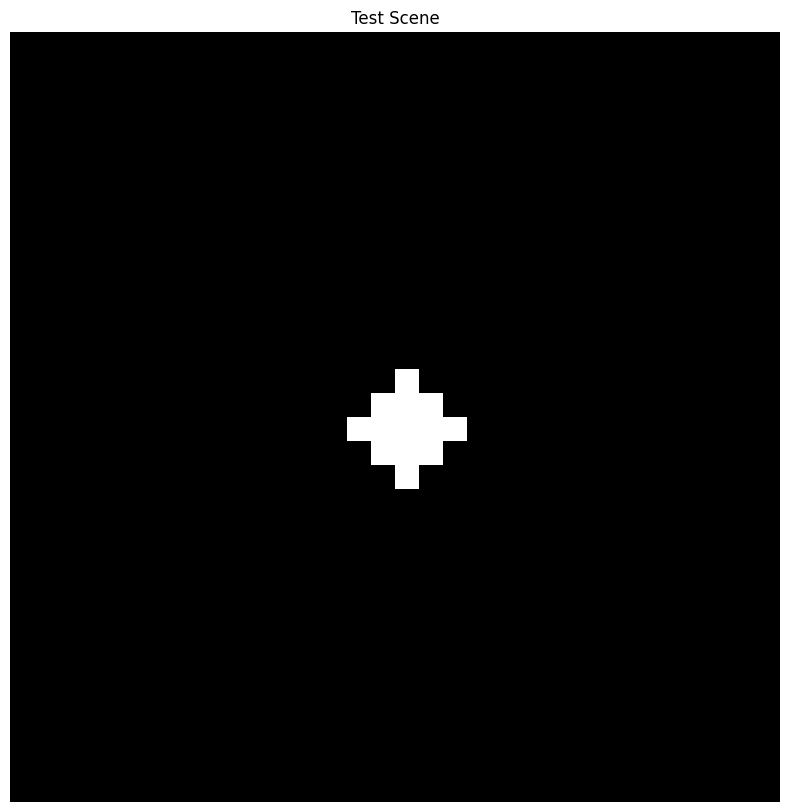

In [11]:
testScene = createTestScene()
print(f'Test Scene Shape: {testScene.shape}')
print(f'Test Scene Data Type: {testScene.dtype}')
plt.figure(figsize=(15,10))
plt.imshow(testScene)
plt.title('Test Scene')
plt.axis('off')
plt.show()

Test Noise Shape: (32, 32, 3)
Test Noise Data Type: float64
Test Noise Min: 0.0
Test Noise Max: 1.0


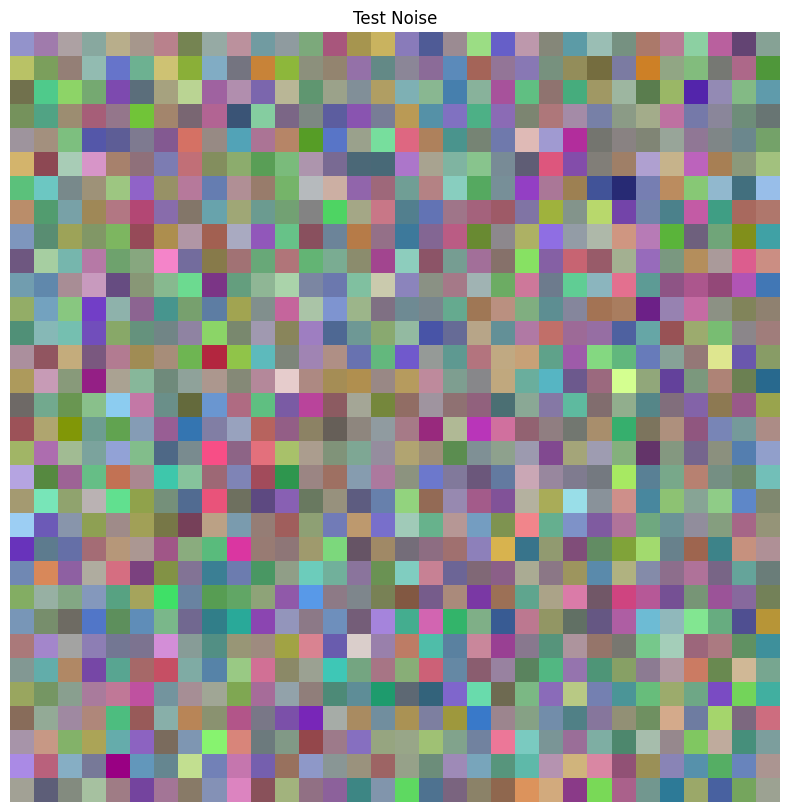

In [12]:
testNoise = createNoise(dist='gauss')
print(f'Test Noise Shape: {testNoise.shape}')
print(f'Test Noise Data Type: {testNoise.dtype}')
print(f'Test Noise Min: {testNoise.min()}')
print(f'Test Noise Max: {testNoise.max()}')
plt.figure(figsize=(15,10))
plt.imshow(testNoise)
plt.title('Test Noise')
plt.axis('off')
plt.show()

In [13]:
# Generate the Noisy Stack 
scale = 1
numStack = 10000
print('Creating Test Stack...')
testStack = np.stack([normalize(testScene + scale*createNoise(dist='uniform')) for _ in tqdm(range(numStack))])
print(f'Test Stack Shape: {testStack.shape}')

Creating Test Stack...


100%|███████████████████████████████████████████████████| 10000/10000 [00:00<00:00, 22534.70it/s]


Test Stack Shape: (10000, 32, 32, 3)


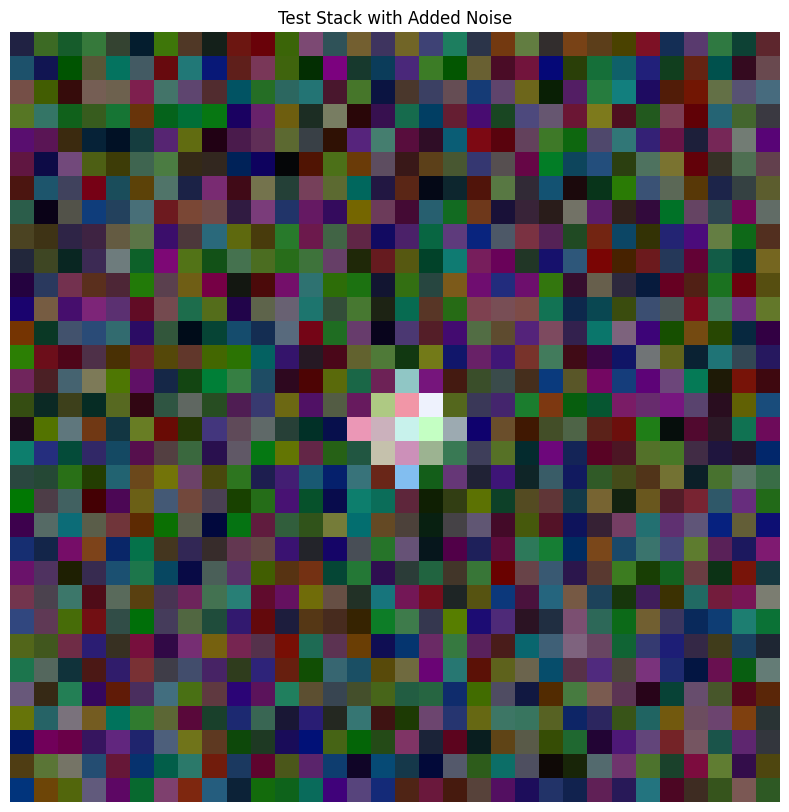

In [14]:
plt.figure(figsize=(15,10))
plt.title('Test Stack with Added Noise')
plt.axis('off')
plt.imshow(contrast_stretch(testStack[0]))
plt.show()

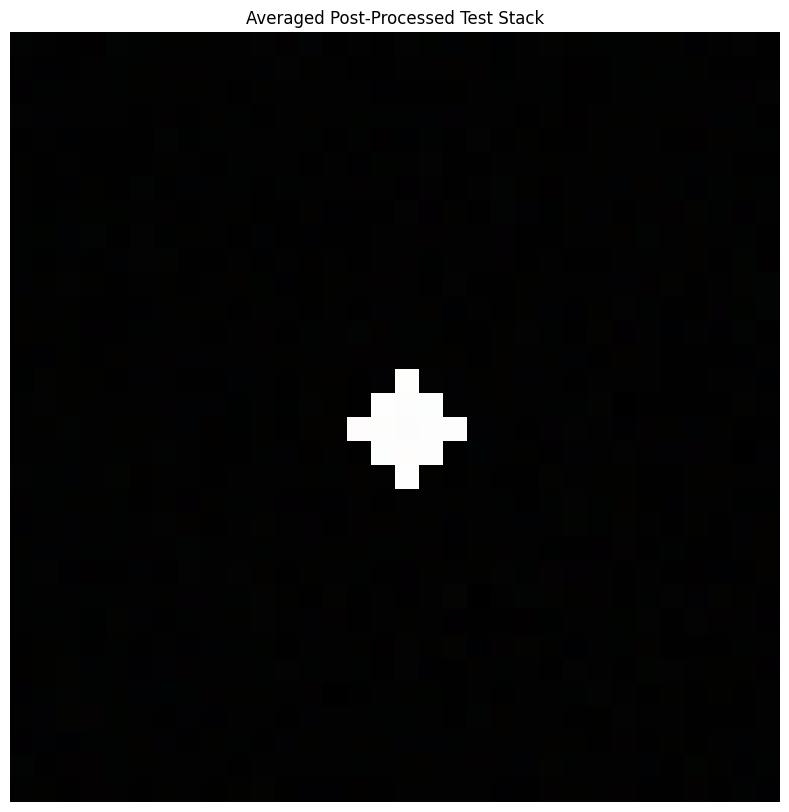

In [15]:
# Viewing the Average Raw Image (Naive Stacking)
testMean = np.mean(testStack,axis=0)
# Plotting the Average
plt.figure(figsize=(15,10))
plt.title(f'Averaged Post-Processed Test Stack')
plt.imshow(contrast_stretch(testMean))
plt.axis('off')
plt.show()

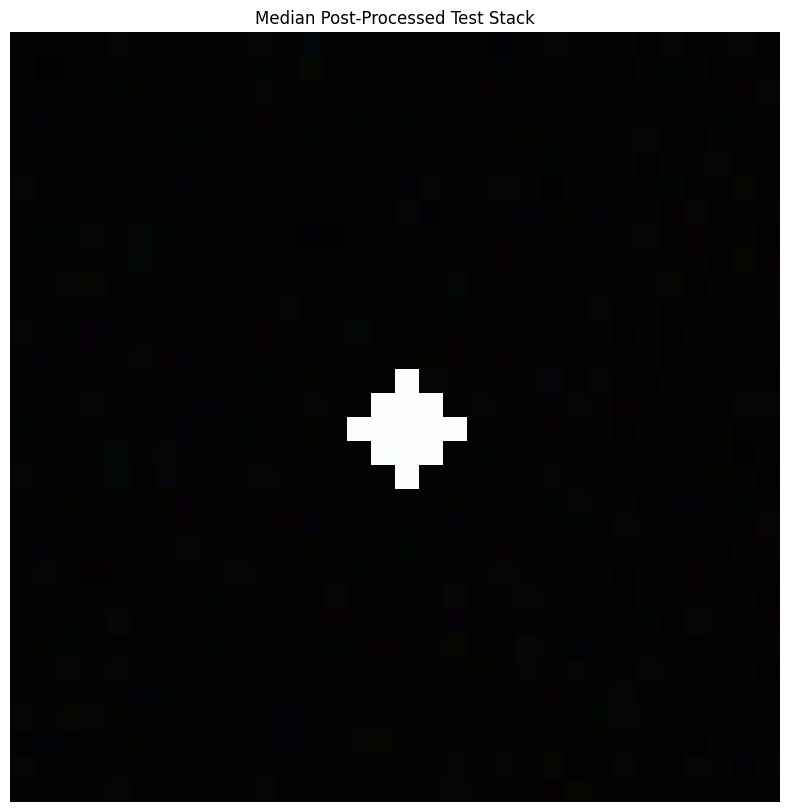

In [16]:
# Viewing the Median Raw Image (Naive Stacking)
testMedian = np.median(testStack,axis=0)
# Plotting the Average
plt.figure(figsize=(15,10))
plt.title(f'Median Post-Processed Test Stack')
plt.imshow(contrast_stretch(testMedian))
plt.axis('off')
plt.show()

### Real Images

As seen above, averaging the noisy image stack elimiantes the zero mean noise, that's because as many samples, it models the  distribution of the noise, which is $\sigma(0,1)$. However, the assumption is the scene is static, which is not the case for the Earth's constant rotation.

Every day, the Earth approximately rotates by 360 degrees, translating to 0.25 degrees a minute. Naively stacking all the images leads to translational error, visually seen in the form of star trails as shown below.

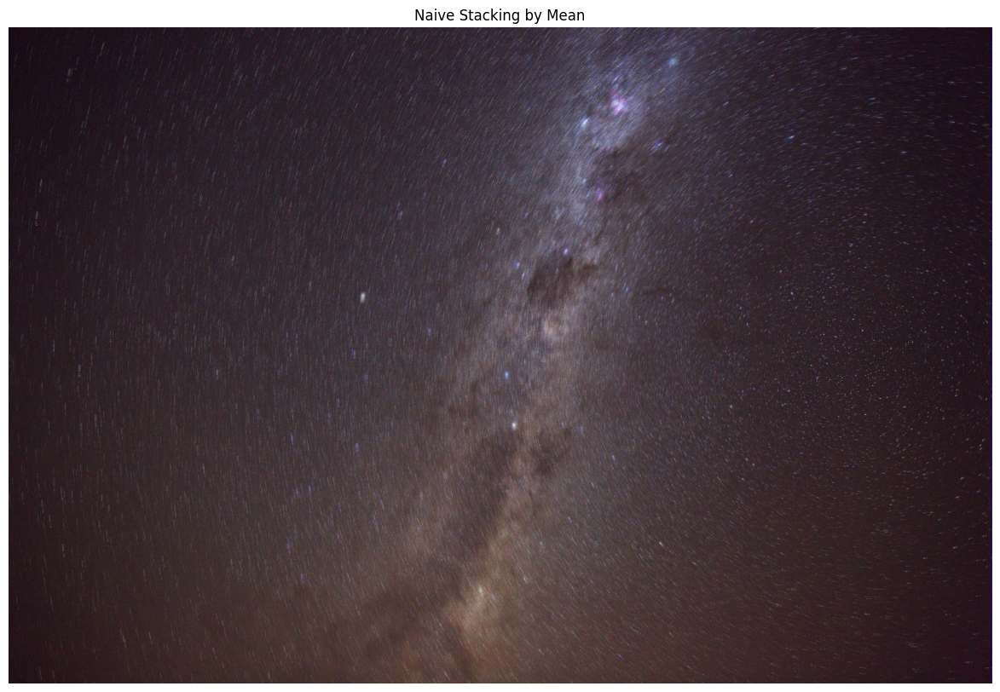

In [17]:
# Viewing the Average Raw Image (Naive Stacking)
stackedMean = np.mean(stackedNumpy,axis=0)
# Plotting the Average
plt.figure(figsize=(15,10))
plt.title(f'Naive Stacking by Mean')
plt.imshow(contrast_stretch(stackedMean))
plt.axis('off')
plt.show()

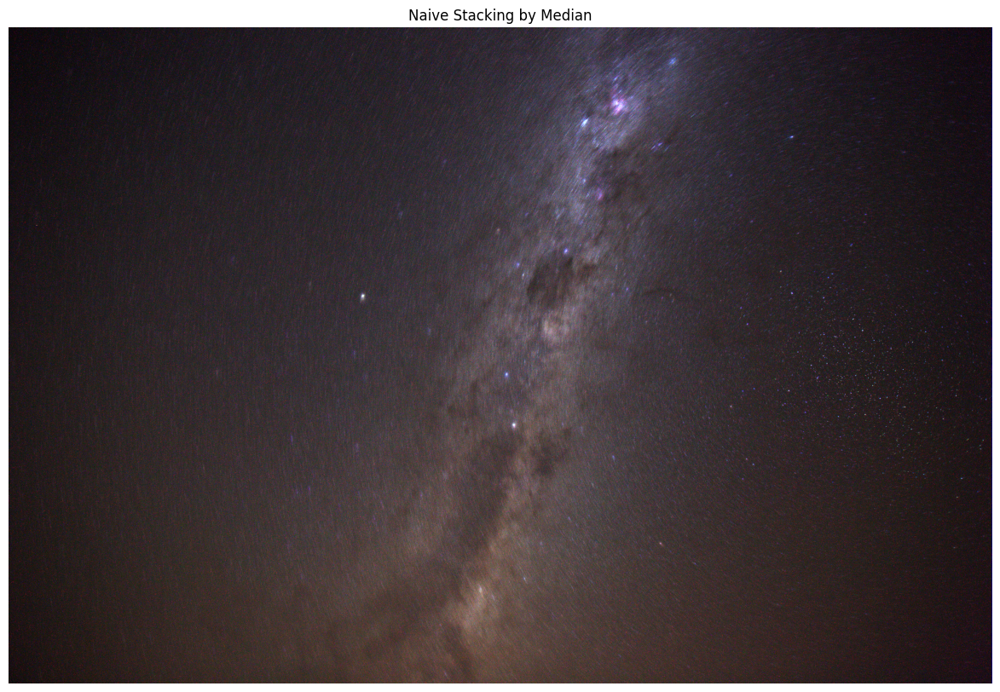

In [18]:
# Viewing the Median Raw Image (Naive Stacking)
stackedMedian = np.median(stackedNumpy,axis=0)
# Plotting the Median
plt.figure(figsize=(15,10))
plt.title(f'Naive Stacking by Median')
plt.imshow(contrast_stretch(stackedMedian))
plt.axis('off')
plt.show()

### Image Registration
In order to correctly stack many astrophotography long exposures, a preprocessing operation of image registration needs to occur to align the images. ORB Image registration finds common keypoints between an image and a reference, estimates the transformation matrix, and maps the new pixels with respect to the reference to correct rotation [2]. This will mitigate the prescence of star trails and allow us to accurately stack our images for a nice celestial object!

In [19]:
# Registers a Float Img (img2) with Respect to a Reference (img1)
def register_image(img1,img2,numFeatures=5000,match=0.9,refill=True):
    # Convert to uint8 grayscale.
    gray1 = cv.cvtColor(float_to_int(img1), cv.COLOR_BGR2GRAY)
    gray2 = cv.cvtColor(float_to_int(img2), cv.COLOR_BGR2GRAY)
    height, width = gray1.shape
    
    # Create ORB detector
    orb_detector = cv.ORB_create(numFeatures)
    
    # Find keypoints and descriptors.
    # The first arg is the image, second arg is the mask
    #  (which is not required in this case).
    kp1, d1 = orb_detector.detectAndCompute(gray1, None)
    kp2, d2 = orb_detector.detectAndCompute(gray2, None)
    
    # Match features between the two images.
    # We create a Brute Force matcher with 
    # Hamming distance as measurement mode.
    matcher = cv.BFMatcher(cv.NORM_HAMMING, crossCheck = True)
    
    # Match the two sets of descriptors.
    matches = list(matcher.match(d1, d2))

    
    # Sort matches on the basis of their Hamming distance.
    matches.sort(key = lambda x: x.distance)
    
    # Take the top matches forward.
    matches = matches[:int(len(matches)*match)]
    no_of_matches = len(matches)
    
    # Define empty matrices of shape no_of_matches * 2.
    p1 = np.zeros((no_of_matches, 2))
    p2 = np.zeros((no_of_matches, 2))
    
    for i in range(len(matches)):
      p1[i, :] = kp1[matches[i].queryIdx].pt
      p2[i, :] = kp2[matches[i].trainIdx].pt
    
    # Find the homography matrix.
    homography, mask = cv.findHomography(p1, p2, cv.RANSAC)
    
    # Use this matrix to transform the
    # colored image wrt the reference image.
    transformed_img = cv.warpPerspective(img1,
                        homography, (width, height))

    if(refill): 
        transformed_img = np.where(transformed_img != 0, transformed_img, img2) 
    
    return transformed_img

# Stacks Images with Automatic Alignment
def stack_images(imgStack,method='mean',align=True,refIndex=0.5,refill=True):
    if align:
        refIndex = len(imgStack) // 2 if refIndex == 0.5 else refIndex
        newImgs = []
        for i in tqdm(range(imgStack.shape[0])): 
            newImgs.append(normalize(imgStack[i]) if i == refIndex else register_image(imgStack[i],imgStack[refIndex],refill=refill))
        imgStack = np.stack(newImgs)
    stackedImg = np.median(imgStack,axis=0) if method == 'med' else np.mean(imgStack,axis=0)
    return stackedImg

In [20]:
# Stacking the Astro Image
stackedImg = stack_images(stackedNumpy)

100%|████████████████████████████████████████████████████████████| 11/11 [00:05<00:00,  2.14it/s]


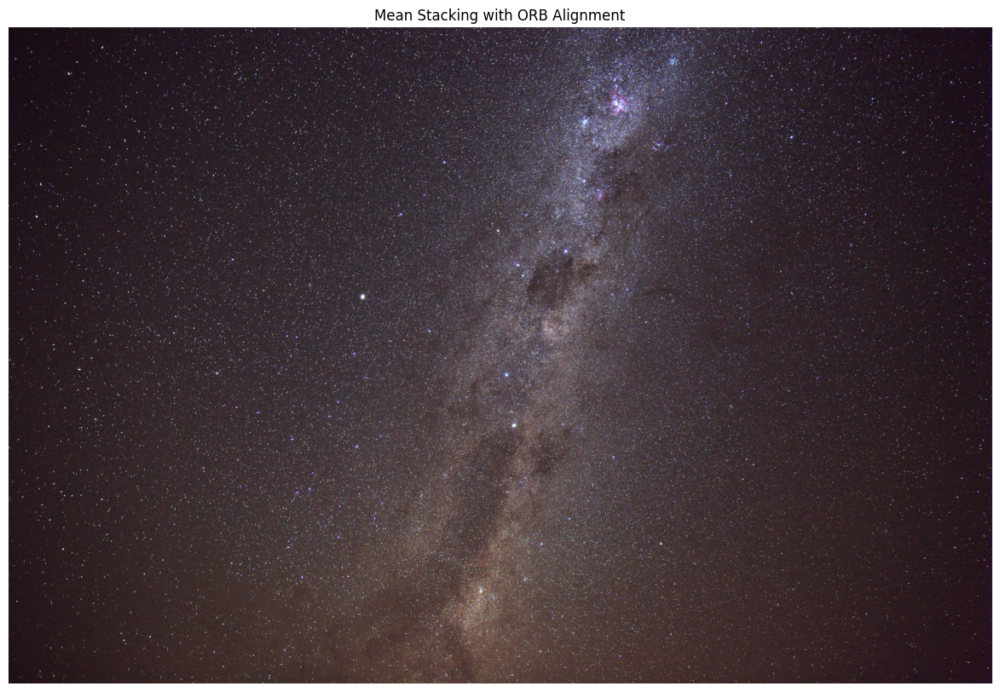

In [21]:
# Plotting the Stacked Image
plt.figure(figsize=(15,10))
plt.title(f'Mean Stacking with ORB Alignment')
plt.imshow(contrast_stretch(stackedImg))
plt.axis('off')
plt.show()

In [22]:
# Writing the Final Result
cv.imwrite(f'{dataDir1}/stackedImg.tiff',float_to_int16(stackedImg)[...,::-1])
print('Saving the Final Result')

Saving the Final Result


Now with Image Registration, the Astrophoto stack was succesfully merged using Python! Feel free to apply any postprocessing tactics to make the images look nice!

In [23]:
# Freeing Up Old Tensors for the Next Experiment
del singleRaw,testScene,testNoise,testStack,testMean,testMedian,stackedNumpy,stackedImg
gc.collect()
print('Freeing up Memory for the next Experiment')

Freeing up Memory for the next Experiment


## Another Example: Andromeda Galaxy (M31)
We will implement the full image stacking pipeline on Andromeda Galaxy (M31) data! This data has been provided by Jerry Lodriguss from [AstroPix](https://www.astropix.com/html/processing/practice_files.html).

In [47]:
# Creating Directory to Store the Data
dataDir2 = f'../data/imagestacking/astropix'
os.makedirs(dataDir2,exist_ok=True)

In [50]:
# Downloading M31 Zip 
m31Link = 'https://drive.google.com/uc?id=19MZpu3mdGXuPvOXg_SIX-Ff57My3Wx8n'
m31Zip = f'{dataDir2}/M31.zip'
m31Dir = f'{dataDir2}/M31'
if(not(os.path.exists(m31Zip))):
    gdown.download(m31Link,output=m31Zip)
if(not(os.path.exists(m31Dir))):
    os.system(f'unzip {m31Zip} -d {m31Dir}')

Downloading...
From (original): https://drive.google.com/uc?id=19MZpu3mdGXuPvOXg_SIX-Ff57My3Wx8n
From (redirected): https://drive.google.com/uc?id=19MZpu3mdGXuPvOXg_SIX-Ff57My3Wx8n&confirm=t&uuid=84053729-8d64-4a12-8b21-0818bba1acbf
To: C:\Users\Timothy Do\Documents\GitHub\astronomy\data\imagestacking\astropix\M31.zip
100%|█████████████████████████████████████████████████████████| 184M/184M [00:02<00:00, 77.0MB/s]


Single Raw Numpy Shape: (1738, 2604, 3)
Single Raw Numpy Data Type: float64


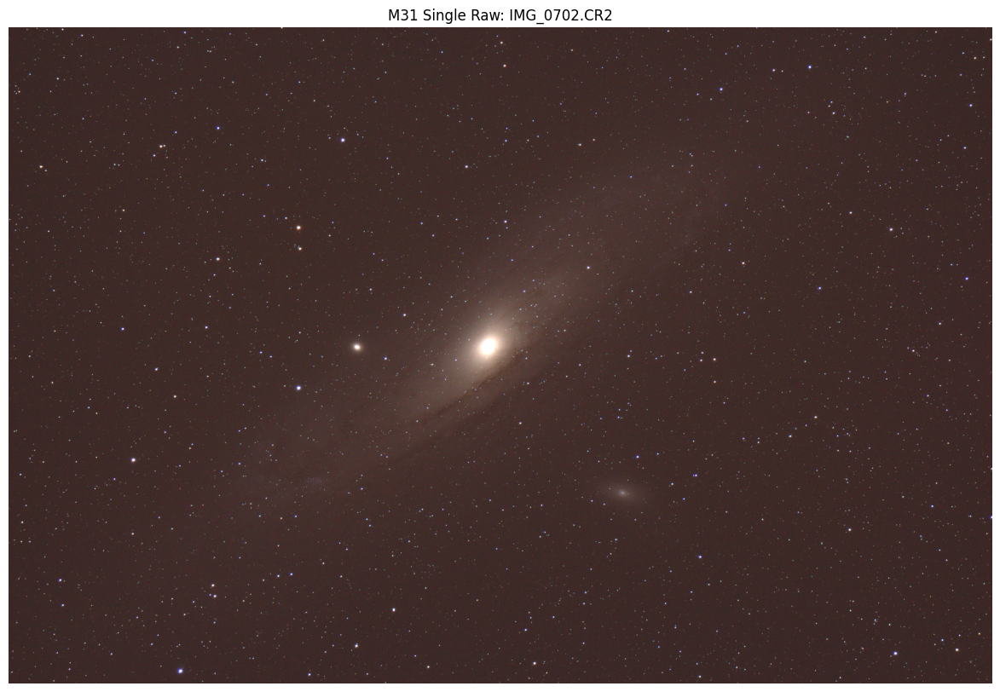

In [115]:
# Extracting Single Raw Image & Viewing
singleRawFile = 'IMG_0702.CR2'
m31StackDir = f'{m31Dir}/M31 RAW 48F ISO800 8min'
singleRawPath = f'{m31StackDir}/{singleRawFile}'
singleRaw = cr2_to_numpy(singleRawPath,use_camera_wb=True,gamma=(2.5,2.5),no_auto_bright=True)
print(f'Single Raw Numpy Shape: {singleRaw.shape}')
print(f'Single Raw Numpy Data Type: {singleRaw.dtype}')
cv.imwrite(f"{dataDir2}/{singleRawFile.strip('.CR2')}.tiff",float_to_int16(singleRaw)[...,::-1])

# Plotting
plt.figure(figsize=(15,10))
plt.title(f'M31 Single Raw: {singleRawFile}')
plt.imshow(contrast_stretch(singleRaw,max=1.5))
plt.axis('off')
plt.show()

In [108]:
# Getting M31 Stack 
m31Stack = cr2Dir_to_tensor(m31StackDir,gamma=(2.5,2.5),use_camera_wb=True,no_auto_bright=True)

Stack Files: ['IMG_0702.CR2', 'IMG_0704.CR2', 'IMG_0705.CR2', 'IMG_0706.CR2', 'IMG_0707.CR2', 'IMG_0708.CR2', 'IMG_0709.CR2', 'IMG_0710.CR2']
Stacking Raw Images into a Tensor


100%|██████████████████████████████████████████████████████████████| 8/8 [00:03<00:00,  2.24it/s]

Stacked Numpy Shape: (8, 1738, 2604, 3)
Stacked Numpy Data Type: float64


In [109]:
# Getting the Stacked Image
m31StackedImg = stack_images(m31Stack)

100%|██████████████████████████████████████████████████████████████| 8/8 [00:02<00:00,  3.05it/s]


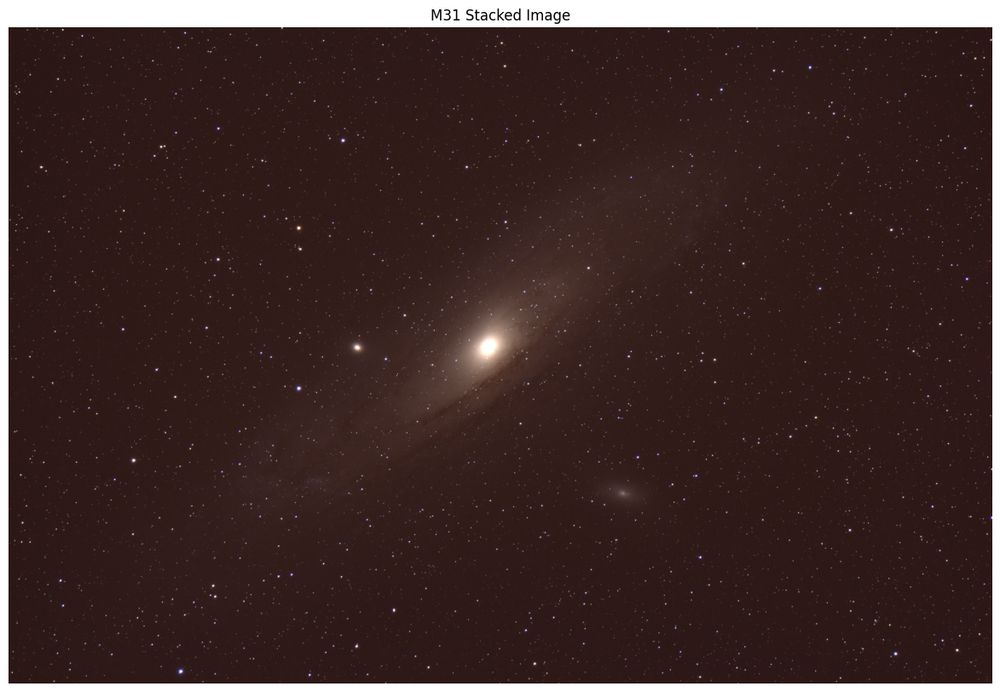

In [113]:
# Plotting the Stacked Image
plt.figure(figsize=(15,10))
plt.title(f'M31 Stacked Image')
plt.imshow(contrast_stretch(m31StackedImg,max=1.5))
plt.axis('off')
plt.show()

In [116]:
# Writing the Final Result
cv.imwrite(f'{dataDir2}/m31StackedImg.tiff',float_to_int16(m31StackedImg)[...,::-1])
print('Saving the Final Result')

Saving the Final Result


## Incorporating Dark Calibration 
<font color='red'>**To Be Completed**</font>

In advanced astrophotography, an astronmer would usually take a set of calibration "dark" images. Dark images are defined as frames that are captured with the lens cap on to only capture the noise with the same camera settings (i.e., same ISO, apeture, shutter speed, etc.). Since the scene is assumed to be zero, the dark images is modeled as: $$I_{dark}(x,y) = n(x,y)$$

For this next section, we will use another dataset provided by Trevor Jones from [AstroBackyard](https://astrobackyard.com/dss-practice-files/). He captures a really nice shot of the North American Nebula with Class 4 Bortle Skies with a Canon EOS Ra Sky-Walker Star Adventurer Star Tracker tracking the movement of the stars (mitigating image registration).

For ease of download, I provided the link for each raw image on Google Drive in a text file.

In [24]:
# Creating Directory to Store the Data
dataDir3 = '../data/imagestacking/astrobackyard'
os.makedirs(dataDir3,exist_ok=True)

In [25]:
# Downloading the AstroBackyard Dataset
astroBackyardDir = f'{dataDir3}/AstroBackyardNorthAmericanNebula'
lightDir = f'{astroBackyardDir}/LIGHTS'
darkDir = f'{astroBackyardDir}/DARKS'
if(not(os.path.exists(astroBackyardDir))):
    if(IN_COLAB): # Downloading GDrive Links for Each Photo
        !curl https://raw.githubusercontent.com/dotimothy/astronomy/main/analysis/AstroBackyardNorthAmericanNebulaLightLinks.txt -o ./AstroBackyardNorthAmericanNebulaLightLinks.txt
        !curl https://raw.githubusercontent.com/dotimothy/astronomy/main/analysis/AstroBackyardNorthAmericanNebulaDarkLinks.txt -o ./AstroBackyardNorthAmericanNebulaDarkLinks.txt
    with open('./AstroBackyardNorthAmericanNebulaLightLinks.txt','r') as lightLinks: # Downloading Light Images
        os.makedirs(lightDir,exist_ok=True)
        print(f'Downloading AstroBackyard Light Images')
        for line in tqdm(lightLinks.readlines()):
            lightLink = line.strip('\n')
            gdown.download(lightLink,output=lightDir,quiet=True)
    with open('./AstroBackyardNorthAmericanNebulaDarkLinks.txt','r') as darkLinks: # Downloading Dark Images
        os.makedirs(darkDir,exist_ok=True)
        print(f'Downloading Astrobackyard Dark Images')
        for line in tqdm(darkLinks.readlines()):
            darkLink = line.strip('\n')
            gdown.download(darkLink,output=darkDir,quiet=True)

Test AstroBackyard Light Shape: (2249, 3371, 3)
Test AstroBackyard Data Type: float64


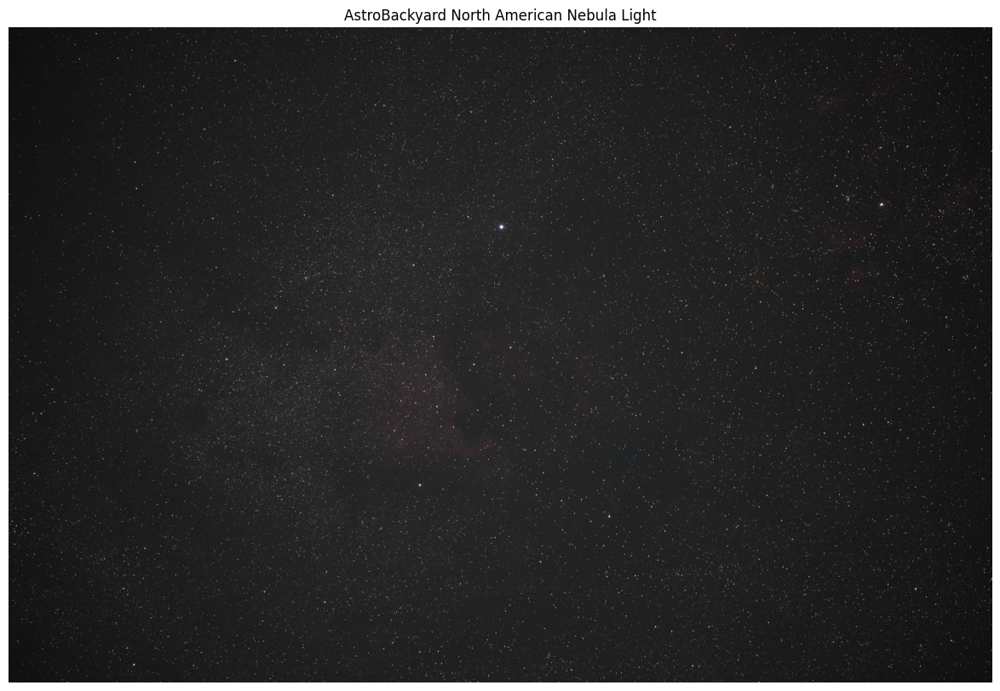

In [46]:
testLight = cr2_to_numpy(f'{lightDir}/1R9A3692.CR3',gamma=(1.25,1.25),use_camera_wb=True,no_auto_bright=True)
print(f'Test AstroBackyard Light Shape: {testLight.shape}')
print(f'Test AstroBackyard Data Type: {testLight.dtype}')
plt.figure(figsize=(15,10))
plt.imshow(testLight)
plt.axis('off')
plt.title('AstroBackyard North American Nebula Light')
plt.show()

Test AstroBackyard Dark Shape: (2249, 3371, 3)
Test AstroBackyard Data Type: float64


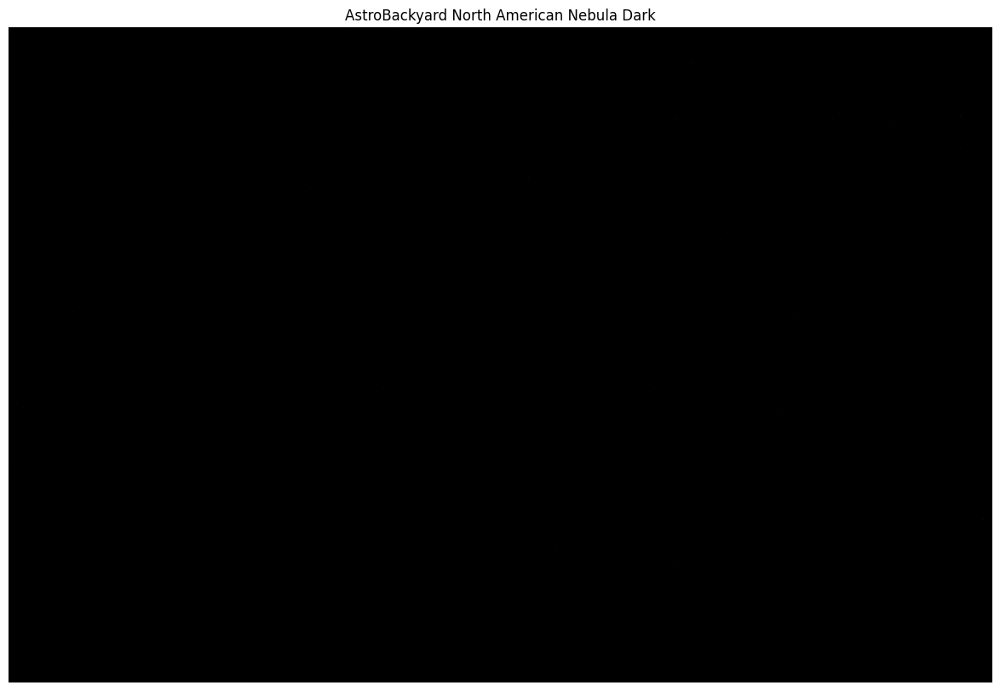

In [27]:
# Test Dark
testDark = cr2_to_numpy(f'{darkDir}/1R9A3804.CR3',use_camera_wb=True,no_auto_bright=True)
print(f'Test AstroBackyard Dark Shape: {testDark.shape}')
print(f'Test AstroBackyard Data Type: {testDark.dtype}')
plt.figure(figsize=(15,10))
plt.imshow(testDark)
plt.axis('off')
plt.title('AstroBackyard North American Nebula Dark')
plt.show()

In [28]:
# Getting the Tensor to Only Stack the Lights
toExclude = [f'1R9A{3740+i}.CR3' for i in range(3768-3740+1)] # Excluded Misoriented Ones
print(f'Excluding: {toExclude}')
lightStack = cr2Dir_to_tensor(lightDir,use_camera_wb=True,exclude=toExclude,no_auto_bright=True)

Excluding: ['1R9A3740.CR3', '1R9A3741.CR3', '1R9A3742.CR3', '1R9A3743.CR3', '1R9A3744.CR3', '1R9A3745.CR3', '1R9A3746.CR3', '1R9A3747.CR3', '1R9A3748.CR3', '1R9A3749.CR3', '1R9A3750.CR3', '1R9A3751.CR3', '1R9A3752.CR3', '1R9A3753.CR3', '1R9A3754.CR3', '1R9A3755.CR3', '1R9A3756.CR3', '1R9A3757.CR3', '1R9A3758.CR3', '1R9A3759.CR3', '1R9A3760.CR3', '1R9A3761.CR3', '1R9A3762.CR3', '1R9A3763.CR3', '1R9A3764.CR3', '1R9A3765.CR3', '1R9A3766.CR3', '1R9A3767.CR3', '1R9A3768.CR3']
Stack Files: ['1R9A3692.CR3', '1R9A3693.CR3', '1R9A3694.CR3', '1R9A3695.CR3', '1R9A3696.CR3', '1R9A3697.CR3', '1R9A3698.CR3', '1R9A3699.CR3', '1R9A3700.CR3', '1R9A3701.CR3', '1R9A3703.CR3', '1R9A3704.CR3', '1R9A3705.CR3', '1R9A3706.CR3', '1R9A3707.CR3', '1R9A3708.CR3', '1R9A3709.CR3', '1R9A3710.CR3', '1R9A3711.CR3', '1R9A3712.CR3', '1R9A3713.CR3', '1R9A3714.CR3', '1R9A3715.CR3', '1R9A3716.CR3', '1R9A3717.CR3', '1R9A3718.CR3', '1R9A3719.CR3', '1R9A3720.CR3', '1R9A3721.CR3', '1R9A3722.CR3', '1R9A3723.CR3', '1R9A3724.CR3'

100%|████████████████████████████████████████████████████████████| 80/80 [00:23<00:00,  3.44it/s]


Stacked Numpy Shape: (80, 2249, 3371, 3)
Stacked Numpy Data Type: float64


In [29]:
# Getting the Tensor to Stack the Darks
darkStack = cr2Dir_to_tensor(darkDir,use_camera_wb=True,no_auto_bright=True)

Stack Files: ['1R9A3804.CR3', '1R9A3805.CR3', '1R9A3806.CR3', '1R9A3807.CR3', '1R9A3808.CR3', '1R9A3809.CR3', '1R9A3810.CR3', '1R9A3811.CR3', '1R9A3812.CR3', '1R9A3813.CR3', '1R9A3814.CR3', '1R9A3815.CR3', '1R9A3816.CR3', '1R9A3817.CR3']
Stacking Raw Images into a Tensor


100%|████████████████████████████████████████████████████████████| 14/14 [00:04<00:00,  3.30it/s]


Stacked Numpy Shape: (14, 2249, 3371, 3)
Stacked Numpy Data Type: float64


In [30]:
# Getting the Stacked Light (without Dark Calibration) 
stackedLight = stack_images(lightStack)

100%|████████████████████████████████████████████████████████████| 80/80 [00:44<00:00,  1.78it/s]


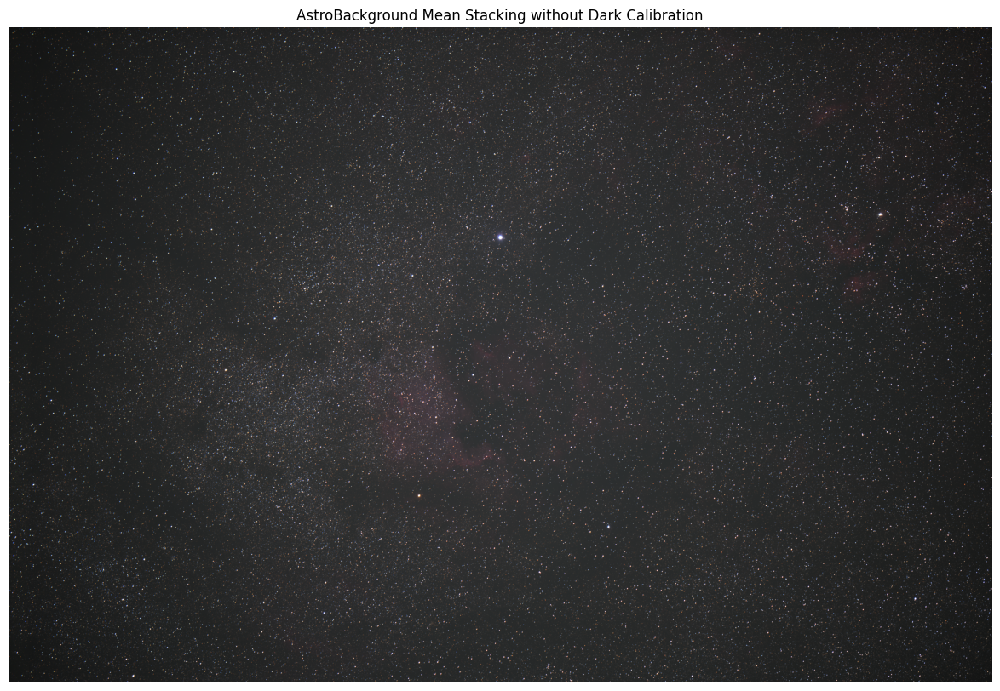

In [35]:
# Plotting the Stacked Image without Dark Calibration
plt.figure(figsize=(15,10))
plt.title(f'AstroBackground Mean Stacking without Dark Calibration')
plt.imshow(contrast_stretch(stackedLight,max=2))
plt.axis('off')
plt.show()